<a href="https://colab.research.google.com/github/MrFlygerian/portfolio-for-data-science/blob/master/Blessed's_Audio_Novoic_ML_challenge.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Imports

- ~TODO: Implement Tensorboard Callback~
- ~TODO: Implement EarlyStopping callback~
- ~TODO: Implement SavedModel callbacks~
- ~TODO: Implement 2 more models from fastai~
- ~TODO: Find a way to save and load models~
- TODO: Generate prediction on custom data (likely a WAV file from an ableton sample pack and a few voice recordings)
- ~TODO: Put model architectures into function~
- TODO: Create useful plots of model architecture performances

<a href="https://novoic.com"><img src="https://assets.novoic.com/logo_320px.png" alt="Novoic logo" width="160"/></a>

# Novoic ML challenge – audio data

This notebook is created using data from Novoic's Machine Learning Audio challenge (part of a series of challenges found in [this repo](https://github.com/novoic/ml-challenge)). 

Most of the code here is adapated from [this article](https://towardsdatascience.com/longform-audio-classification-in-fastaudio-76d81825d29b) and lots of help from fastai's documentation.

## Data description

The data comprises 23,682 audio files in wav format. Each file is about 1 second in length and contains one word from: up, down, left, right, yes, no, on, off, stop, go.

The audio files are organized into folders based on the word they contain. The files are not uniquely named across labels, but they are unique if you include the label folder. For example, `0137b3f4_nohash_2.wav` is found in multiple folders but contains a different speech command in each.



The files are named such that the first element (e.g. `0137b3f4`) is the subject id of the person who gave the voice command, and the last element (e.g. `2`) indicates the index of a possibly repeated command. Each participant submitted one or more recordings of each word.

There are some inconsistencies in the properties of the training data (e.g. length of audio or its content).

For more information about the dataset, see its `README.md`.

Directory structure:
```
data/
├── up/       # dir for 'up' files
├── down/     # dir for 'down' files
├── left/     # dir for 'left' files
├── right/    # dir for 'right' files
├── yes/      # dir for 'yes' files
├── no/       # dir for 'no' files
├── on/       # dir for 'on' files
├── off/      # dir for 'off' files
├── stop/     # dir for 'stop' files
├── go/       # dir for 'go' files
├── LICENSE
└── README.md
```






In [ ]:
%pip install ipython-autotime
%load_ext autotime

time: 2 ms (started: 2021-01-04 20:03:30 +00:00)


In [ ]:
# Copying the dataset to a local directory
!mkdir -p data
!gsutil -mq cp -r gs://novoic-ml-challenge-audio-data/* ./data

time: 5min 9s (started: 2021-01-04 20:03:30 +00:00)


## Imports

In [ ]:
%pip install torch==1.7.1+cu92 torchvision==0.8.2+cu92 -f https://download.pytorch.org/whl/torch_stable.html
%pip install torchaudio
%pip install git+https://github.com/fastaudio/fastaudio.git

Looking in links: https://download.pytorch.org/whl/torch_stable.html
  Cloning https://github.com/fastaudio/fastaudio.git to /tmp/pip-req-build-bx914zd4
  Running command git clone -q https://github.com/fastaudio/fastaudio.git /tmp/pip-req-build-bx914zd4
  Created wheel for fastaudio: filename=fastaudio-0.1.3-py2.py3-none-any.whl size=18054 sha256=25e60b2d9cdf83debe3cb2c89003ae2c0b4aba2d4cb124abc7711a5e6510d7c2
  Stored in directory: /tmp/pip-ephem-wheel-cache-ukwbljkg/wheels/20/af/b1/ea2a6d91971f5e3f435c6a0aa2ae8b7a010b644cc01e24b0ce
Successfully built fastaudio


In [ ]:
from numpy.random import seed
seed(888)

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import sklearn
from sklearn.model_selection import train_test_split

import IPython 

import torch
import torchaudio

import glob

from fastai import *
from fastai.callback.tensorboard import *
from fastai.vision.all import *

from fastaudio.core.all import *
from fastaudio.augment.all import *
from fastaudio.ci import skip_if_ci

/usr/local/lib/python3.6/dist-packages/torchaudio/backend/utils.py:54: UserWarning: "sox" backend is being deprecated. The default backend will be changed to "sox_io" backend in 0.8.0 and "sox" backend will be removed in 0.9.0. Please migrate to "sox_io" backend. Please refer to https://github.com/pytorch/audio/issues/903 for the detail.
  '"sox" backend is being deprecated. '


### Constants

In [ ]:
DATA_DIR = 'data/'
AUDIO_FOLDERS = ['down', 'go', 'left', 'no', 'off', 'on', 'right', 'stop', 'up', 'yes']
LOG_DIR = 'tb_novoic_audio_logs'
# MODELS_DIR = 'models/'

BATCH_SIZE = 64
EPOCHS = 5
N_FOLDS = 5
# EPOCH_PCT = 0.2

## Data Prep

In [ ]:
audio_dict = {folder:glob.glob(DATA_DIR + folder + '/' + '*.wav') for folder in AUDIO_FOLDERS}

frames = []
for i in audio_dict:
  frames.append(pd.DataFrame(audio_dict[i], index=[i for l in range(len(audio_dict[i]))]))

df = pd.concat(frames, axis=0)
df['file_name'] = df[0]
df['target'] = df.index
df.reset_index(inplace=True)
df.drop(columns=['index', 0], inplace=True)

## Data Exploration

In [ ]:
df = df.sample(frac=1).reset_index(drop=True)
df.head()

,file_name,target
0,data/up/92a9c5e6_nohash_4.wav,up
1,data/right/c634a189_nohash_3.wav,right
2,data/off/3da7f617_nohash_0.wav,off
3,data/up/ae04cdbe_nohash_0.wav,up
4,data/up/106a6183_nohash_2.wav,up


In [ ]:
df.shape

(23682, 2)

/usr/local/lib/python3.6/dist-packages/torch/functional.py:516: UserWarning: stft will require the return_complex parameter be explicitly  specified in a future PyTorch release. Use return_complex=False  to preserve the current behavior or return_complex=True to return  a complex output. (Triggered internally at  /pytorch/aten/src/ATen/native/SpectralOps.cpp:653.)
  normalized, onesided, return_complex)
/usr/local/lib/python3.6/dist-packages/torch/functional.py:516: UserWarning: The function torch.rfft is deprecated and will be removed in a future PyTorch release. Use the new torch.fft module functions, instead, by importing torch.fft and calling torch.fft.fft or torch.fft.rfft. (Triggered internally at  /pytorch/aten/src/ATen/native/SpectralOps.cpp:590.)
  normalized, onesided, return_complex)


File:	 data/up/7ea032f3_nohash_2.wav
Label:	 up
Shape of waveform:	 torch.Size([1, 16000])
Sample rate of waveform:	 16000
Shape of spectrogram:	 torch.Size([1, 201, 81])


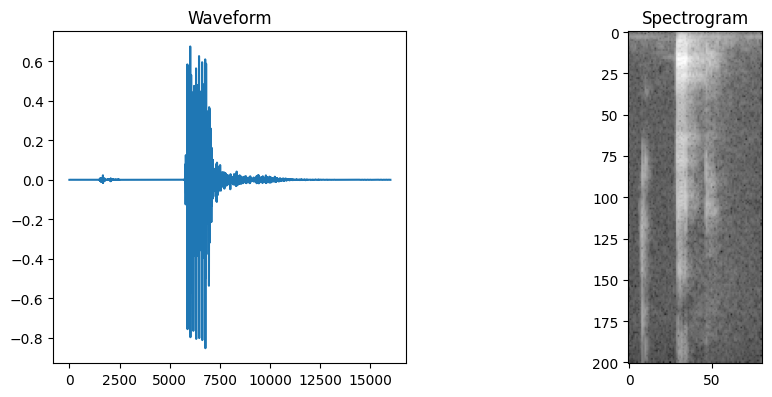

In [ ]:
# Example
sample_sound_file, sample_sound_label = df.sample(n=1).iloc[0]
waveform, sample_rate = torchaudio.load(sample_sound_file)
specgram = torchaudio.transforms.Spectrogram()(waveform)

print('File:\t', sample_sound_file) 
print('Label:\t', sample_sound_label)

print('Shape of waveform:\t', waveform.size())
print('Sample rate of waveform:\t', sample_rate)

print('Shape of spectrogram:\t', specgram.size())


fig, axes = plt.subplots(1,2, figsize = (10,5))
fig.set_dpi(100)
plt.tight_layout(pad = 5)
axes[0].plot(waveform.t().numpy()), axes[0].title.set_text('Waveform')
axes[1].imshow(specgram.log2()[0,:,:].numpy(), cmap='gray'), axes[1].title.set_text('Spectrogram')
plt.show()

IPython.display.Audio(filename=sample_sound_file)

## Splitting data

In [ ]:
train_df, test_df = train_test_split(df, test_size = 0.09)

In [ ]:
# Helper function to split the data
def CrossValidationSplitter(col='fold', fold=1):
    "Split `items` (supposed to be a dataframe) by fold in `col`"
    def _inner(o):
        assert isinstance(o, pd.DataFrame), "ColSplitter only works when your items are a pandas DataFrame"
        col_values = o.iloc[:,col] if isinstance(col, int) else o[col]
        valid_idx = (col_values == fold).values.astype('bool')
        return IndexSplitter(mask2idxs(valid_idx))(o)
    return _inner


# Create folds column
def create_folds(num_folds, df):
  fold_nums = []
  fold_length = (len(df) + (num_folds-1)) // num_folds

  for l in range(1,fold_length+1):
    for f in range(1,num_folds+1):
      fold_nums.append(f)
      if len(fold_nums) >= len(df):
        break
  return fold_nums

In [ ]:
train_df['fold'] = create_folds(N_FOLDS, train_df)
train_df.head()

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


,file_name,target,fold
15886,data/on/229978fd_nohash_3.wav,on,1
19958,data/down/5c237956_nohash_0.wav,down,2
17735,data/up/748cb308_nohash_0.wav,up,3
11723,data/down/e9901cf0_nohash_0.wav,down,4
17037,data/on/94de6a6a_nohash_1.wav,on,5


## Deep Learning with fastai

In [ ]:
cfg = AudioConfig.BasicMelSpectrogram(n_fft=512, n_mels = 32)
a2s = AudioToSpec.from_cfg(cfg)

In [ ]:
item_tfms = [ResizeSignal(1000), Resample(8000), DownmixMono()] # https://forums.fast.ai/t/fastai-v2-audio/53535/99
batch_tfms = [a2s]

In [ ]:
# Note: important to distinguish between item tfms and batch tfms
# I made the mistake of confusing the two and got stuck on debugging for a few hours lol
auds = DataBlock(blocks = (AudioBlock, CategoryBlock),  
                 get_x = ColReader("file_name"), 
                 batch_tfms = batch_tfms,
                 item_tfms = item_tfms,
                 splitter = CrossValidationSplitter(col = 'fold', fold = 5),
                 get_y = ColReader("target"))


train_dbunch = auds.dataloaders(train_df, bs=BATCH_SIZE)

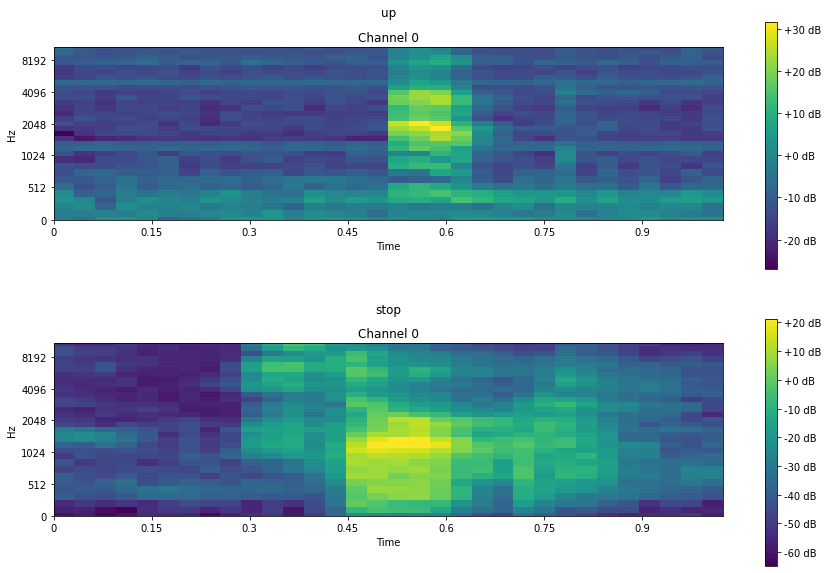

In [ ]:
train_dbunch.show_batch(figsize=(15, 10))

In [ ]:
def build_cnn_learner(databunch, arch):

  return cnn_learner(databunch, 
                     arch,
                     config=cnn_config(n_in=1), #<- Only audio specific modification here
                     # config={"n_in":1},
                     loss_func=CrossEntropyLossFlat(),
                     metrics=[accuracy, F1Score(average='macro')]
                     )

In [ ]:
learn_res_152 = build_cnn_learner(train_dbunch, models.resnet152)
learn_res_152.summary()

Downloading: "https://download.pytorch.org/models/resnet152-b121ed2d.pth" to /root/.cache/torch/hub/checkpoints/resnet152-b121ed2d.pth


Sequential (Input shape: ['64 x 1 x 32 x 32'])
Layer (type)         Output Shape         Param #    Trainable 
Conv2d               64 x 64 x 16 x 16    3,136      False     
________________________________________________________________
BatchNorm2d          64 x 64 x 16 x 16    128        True      
________________________________________________________________
ReLU                 64 x 64 x 16 x 16    0          False     
________________________________________________________________
MaxPool2d            64 x 64 x 8 x 8      0          False     
________________________________________________________________
Conv2d               64 x 64 x 8 x 8      4,096      False     
________________________________________________________________
BatchNorm2d          64 x 64 x 8 x 8      128        True      
________________________________________________________________
Conv2d               64 x 64 x 8 x 8      36,864     False     
___________________________________________________

In [ ]:
learn_vgg19 = build_cnn_learner(train_dbunch, models.vgg19_bn)
learn_vgg19.summary()

Downloading: "https://download.pytorch.org/models/vgg19_bn-c79401a0.pth" to /root/.cache/torch/hub/checkpoints/vgg19_bn-c79401a0.pth


Sequential (Input shape: ['64 x 1 x 32 x 32'])
Layer (type)         Output Shape         Param #    Trainable 
Conv2d               64 x 64 x 32 x 32    640        False     
________________________________________________________________
BatchNorm2d          64 x 64 x 32 x 32    128        True      
________________________________________________________________
ReLU                 64 x 64 x 32 x 32    0          False     
________________________________________________________________
Conv2d               64 x 64 x 32 x 32    36,928     False     
________________________________________________________________
BatchNorm2d          64 x 64 x 32 x 32    128        True      
________________________________________________________________
ReLU                 64 x 64 x 32 x 32    0          False     
________________________________________________________________
MaxPool2d            64 x 64 x 16 x 16    0          False     
___________________________________________________

In [ ]:
learn_squeeze_11 = build_cnn_learner(train_dbunch, models.squeezenet1_1)
learn_squeeze_11.summary()

Downloading: "https://download.pytorch.org/models/squeezenet1_1-f364aa15.pth" to /root/.cache/torch/hub/checkpoints/squeezenet1_1-f364aa15.pth


Sequential (Input shape: ['64 x 1 x 32 x 32'])
Layer (type)         Output Shape         Param #    Trainable 
Conv2d               64 x 64 x 15 x 15    640        False     
________________________________________________________________
ReLU                 64 x 64 x 15 x 15    0          False     
________________________________________________________________
MaxPool2d            64 x 64 x 7 x 7      0          False     
________________________________________________________________
Conv2d               64 x 16 x 7 x 7      1,040      False     
________________________________________________________________
ReLU                 64 x 16 x 7 x 7      0          False     
________________________________________________________________
Conv2d               64 x 64 x 7 x 7      1,088      False     
________________________________________________________________
ReLU                 64 x 64 x 7 x 7      0          False     
___________________________________________________

In [ ]:
learn_dense_161 = build_cnn_learner(train_dbunch, models.densenet161)
learn_dense_161.summary()

Downloading: "https://download.pytorch.org/models/densenet161-8d451a50.pth" to /root/.cache/torch/hub/checkpoints/densenet161-8d451a50.pth


Sequential (Input shape: ['64 x 1 x 32 x 32'])
Layer (type)         Output Shape         Param #    Trainable 
Conv2d               64 x 96 x 16 x 16    4,704      False     
________________________________________________________________
BatchNorm2d          64 x 96 x 16 x 16    192        True      
________________________________________________________________
ReLU                 64 x 96 x 16 x 16    0          False     
________________________________________________________________
MaxPool2d            64 x 96 x 8 x 8      0          False     
________________________________________________________________
BatchNorm2d          64 x 96 x 8 x 8      192        True      
________________________________________________________________
ReLU                 64 x 96 x 8 x 8      0          False     
________________________________________________________________
Conv2d               64 x 192 x 8 x 8     18,432     False     
___________________________________________________

In [ ]:
def get_TB(name):
  folder_name = f'{name}_logs'
  dir_paths = os.path.join(LOG_DIR, folder_name)
  try:
    os.makedirs(dir_paths)
  except OSError as err:
    print (f'{err.strerror} for {name}')
  else:
    print (f'made directory for {name}')
  
  return TensorBoardCallback(log_dir=dir_paths)

def get_callbacks(name):
  return [
          get_TB(name),
          SaveModelCallback(fname=name, with_opt=True, monitor='accuracy'),
          EarlyStoppingCallback(monitor='accuracy', min_delta=0.1, patience=5),
          ShortEpochCallback(pct=0.9, short_valid=False),
          ReduceLROnPlateau(monitor='accuracy', min_delta=0.1, patience=5),
          BnFreeze()
          ]

In [ ]:
# Train resnet
learn_res_152.fit_one_cycle(n_epoch=EPOCHS, cbs=get_callbacks('resnet_152'))

# Train VGG19
learn_vgg19.fine_tune(epochs=EPOCHS, cbs=get_callbacks('vgg19'))

# Train squeezenet
learn_squeeze_11.fit_one_cycle(n_epoch=EPOCHS, cbs=get_callbacks('squeeze_11'))

# Train densenet
learn_dense_161.fine_tune(epochs=EPOCHS, cbs=get_callbacks('dense_161'))

made directory for resnet_152


Better model found at epoch 0 with accuracy value: 0.2777540875568101.
Better model found at epoch 1 with accuracy value: 0.5217586694587486.
Better model found at epoch 2 with accuracy value: 0.6750151867439047.
Better model found at epoch 3 with accuracy value: 0.7458049034731611.
Better model found at epoch 4 with accuracy value: 0.7530725981158816.
made directory for vgg19


Better model found at epoch 0 with accuracy value: 0.2598680573475748.


Better model found at epoch 0 with accuracy value: 0.6449808503060046.
Better model found at epoch 1 with accuracy value: 0.8666561341779669.
Better model found at epoch 2 with accuracy value: 0.9004055186129666.
Better model found at epoch 3 with accuracy value: 0.9125362608782644.
Better model found at epoch 4 with accuracy value: 0.9160518194136495.
made directory for squeeze_11


Better model found at epoch 0 with accuracy value: 0.2540219946250056.
Better model found at epoch 1 with accuracy value: 0.28323529527381014.
Better model found at epoch 2 with accuracy value: 0.3001766351917225.
Better model found at epoch 3 with accuracy value: 0.3029701605030902.
Better model found at epoch 4 with accuracy value: 0.3041007686347017.
made directory for dense_161


Better model found at epoch 0 with accuracy value: 0.5050820733759396.


Better model found at epoch 0 with accuracy value: 0.679469888133237.
Better model found at epoch 1 with accuracy value: 0.7844232678935363.
Better model found at epoch 2 with accuracy value: 0.8271280310737783.
Better model found at epoch 3 with accuracy value: 0.8426531047883185.


## Evaluation

In [ ]:
%load_ext tensorboard
# %reload_ext tensorboard

%tensorboard --logdir tb_novoic_audio_logs

<IPython.core.display.Javascript object>

In [ ]:
def plot_performance(model):
  return None

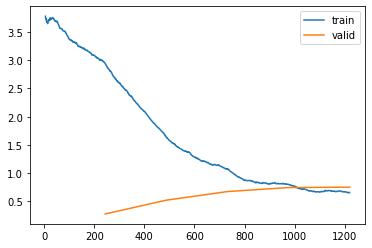

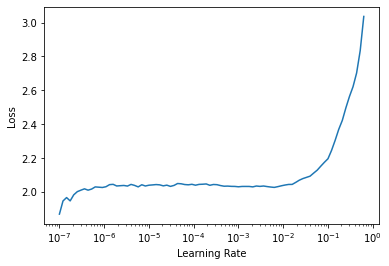

In [ ]:
try:
  learn_res_152.recorder.plot_loss()
except Exception as e:
  print(e)
  pass
  
learn_squeeze_11.lr_find()
# learn_dense_161.recorder.plot_sched()
plt.show()

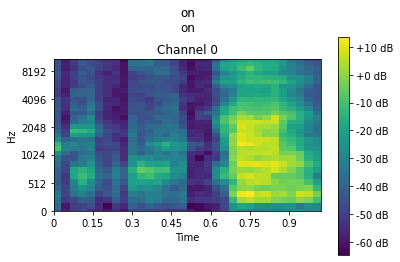

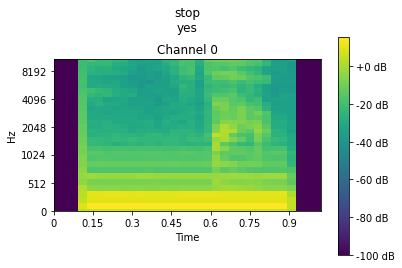

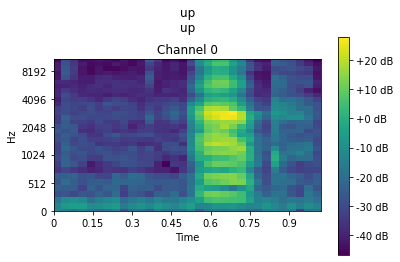

In [ ]:
# learn_dense_161.predict(test_df.file_name.iloc[9])
learn_dense_161.show_results(max_n=3)

[('go', 'no', 87), ('no', 'go', 85), ('off', 'up', 52), ('no', 'down', 48), ('stop', 'up', 43), ('down', 'no', 41), ('up', 'off', 36), ('go', 'down', 35), ('down', 'go', 33), ('on', 'off', 31), ('right', 'left', 29), ('up', 'stop', 26), ('left', 'right', 21), ('off', 'on', 21), ('stop', 'off', 19), ('yes', 'left', 17), ('on', 'go', 14), ('on', 'up', 14), ('down', 'yes', 13), ('go', 'on', 13), ('on', 'no', 13), ('yes', 'no', 12), ('left', 'yes', 11), ('no', 'yes', 11), ('off', 'stop', 11), ('up', 'left', 11), ('down', 'on', 10), ('left', 'up', 10), ('no', 'stop', 10), ('on', 'right', 10), ('right', 'on', 10), ('stop', 'yes', 10), ('yes', 'stop', 10), ('left', 'stop', 9), ('stop', 'left', 9), ('go', 'stop', 8), ('left', 'no', 8), ('stop', 'go', 8), ('stop', 'no', 8), ('up', 'go', 8), ('up', 'no', 8), ('down', 'up', 7), ('go', 'yes', 7), ('no', 'on', 7), ('off', 'left', 7), ('stop', 'on', 7), ('up', 'yes', 7), ('yes', 'go', 7), ('down', 'stop', 6), ('go', 'off', 6), ('go', 'up', 6), ('on'

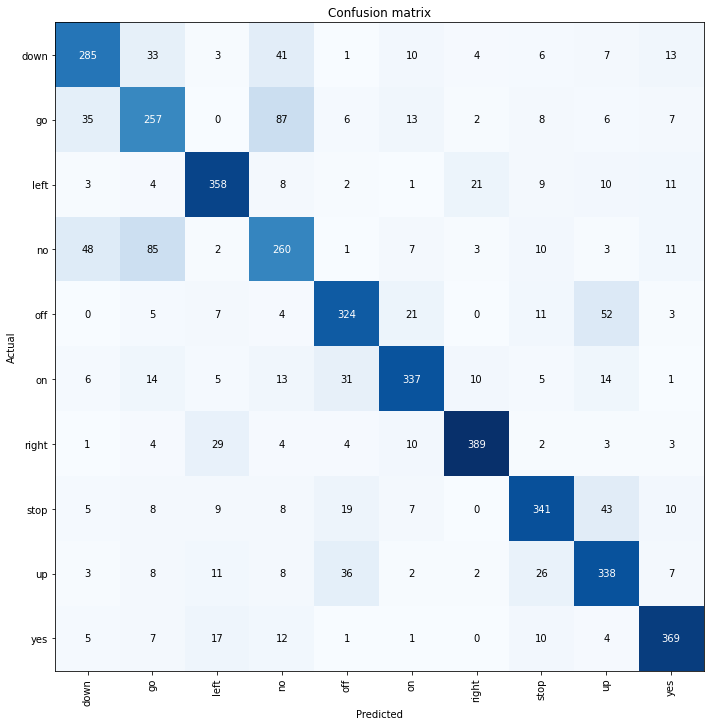

In [ ]:
interp = ClassificationInterpretation.from_learner(learn_res_152)
print(interp.most_confused(min_val=2))
interp.plot_confusion_matrix(figsize=(10, 10))

## Tests

In [ ]:
test_df['fold'] = create_folds(N_FOLDS, test_df)
test_dbunch = auds.dataloaders(test_df, bs=BATCH_SIZE)
test_df.head()


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


,file_name,target,fold
19404,data/no/bc065a17_nohash_0.wav,no,1
16820,data/off/d71ad617_nohash_0.wav,off,2
15884,data/up/f216055e_nohash_0.wav,up,3
21037,data/on/b9db6e42_nohash_1.wav,on,4
7621,data/stop/a74f3917_nohash_1.wav,stop,5


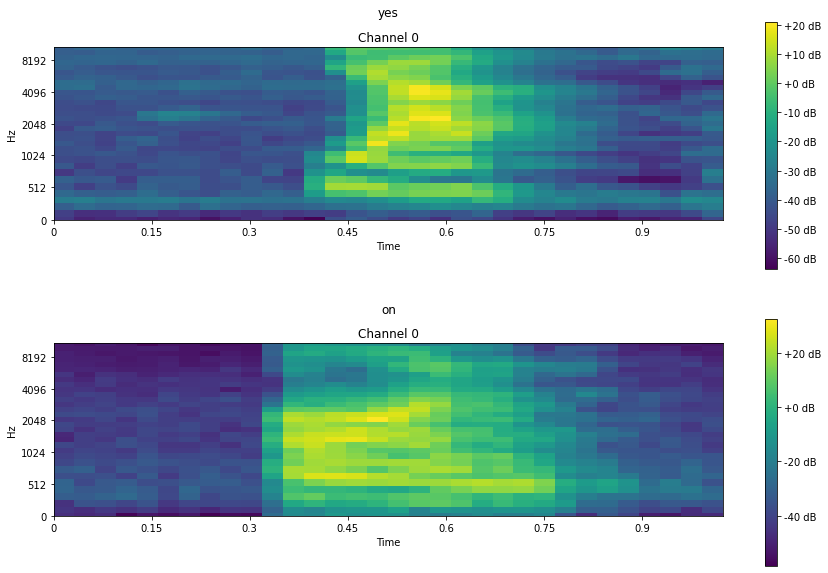

In [ ]:
test_dbunch = auds.dataloaders(test_df, bs=BATCH_SIZE)
test_dbunch.show_batch(figsize=(15, 10))

In [ ]:
b = build_cnn_learner(test_dbunch, models.squeezenet1_1)
b.load('squeeze_11')

In [ ]:
b.fine_tune(6, cbs = get_callbacks('b'))

made directory for b


Better model found at epoch 0 with accuracy value: 0.35781255446526133.


Better model found at epoch 0 with accuracy value: 0.3381297451004006.
Better model found at epoch 1 with accuracy value: 0.37605784476432047.
Better model found at epoch 3 with accuracy value: 0.40510256325635374.
Better model found at epoch 4 with accuracy value: 0.41148286751042684.
Better model found at epoch 5 with accuracy value: 0.43328572429851986.
No improvement since epoch 0: early stopping


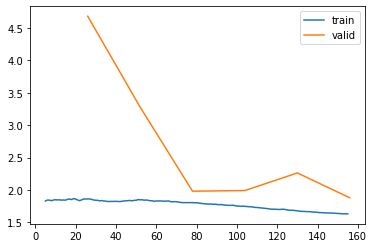

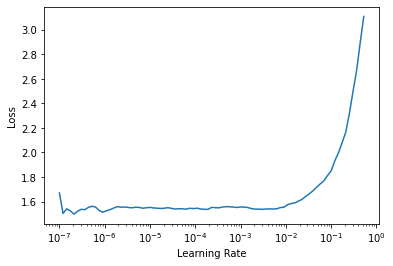

In [ ]:
try:
  b.recorder.plot_loss()
except Exception as e:
  print(e)
  pass
  
b.lr_find()
# learn_dense_161.recorder.plot_sched()
plt.show()

To load saved models use:


`learner = cnn_learner(data, archticture,...)` and then use `learner.load('model_pth_file')`

You can also just use the `model_dir` var like
```
learner = cnn_learner(data, architecture,..., model_dir ='model_pth_file',...,)
```

Both will create a `learner` object with the pretrained weights and tensors.



In [ ]:
# # 
# prior_callbacks = [GradientAccumulation(n_acc=1000),
#                    BnFreeze(),
#                    ShortEpochCallback(pct=0.001, short_valid=False)]

# tracker_callbacks = [EarlyStoppingCallback(monitor='accuracy', min_delta=0.1, patience=2),
#                      ReduceLROnPlateau(monitor='valid_loss', min_delta=0.1, patience=2),
#            #          TensorBoardCallback(log_dir='resnet'),
#                      SaveModelCallback(fname='stage-1')]



    
# callbacks = GradientAccumulation(n_acc=1000),BnFreeze(),
#                    ShortEpochCallback(pct=0.001, short_valid=False),
#                    EarlyStoppingCallback(monitor='accuracy', min_delta=0.1, patience=2),
#                    ReduceLROnPlateau(monitor='valid_loss', min_delta=0.1, patience=2),
#                    get_TB('model'),
#                    SaveModelCallback(fname='stage-1')

                                      

In [ ]:
# try:
#   learn_dense_161.recorder.plot_loss()
# except Exception as e:
#   print(e)
#   pass
  
# learn_dense_161.lr_find()
# learn_dense_161.recorder.plot_sched()
# plt.show()

In [ ]:
# interp = ClassificationInterpretation.from_learner(learn_dense_161)
# print(interp.most_confused())
# interp.plot_confusion_matrix(figsize=(10, 10))

In [ ]:
# from fastai.callback.tracker import SaveModelCallback
# from fastai.callback.tracker import EarlyStoppingCallback
# @skip_if_ci
# def run_learner():
#     # epochs are a bit longer due to the chosen melspectrogram settings
#     learn.fine_tune(epochs = EPOCHS, cbs = [SaveModelCallback(monitor='error_rate', fname='stage-1')])
# # We only validate the model when running in CI
# run_learner()

In [ ]:
# EarlyStoppingCallback(monitor='', min_delta=0.01, patience=7)

In [ ]:
# # Create folds column
# n_folds = 5
# def create_folds(iter, df):
#   jump = df.shape[0]//n_folds
#   if (iter == 0): return [1]
#   return [iter]*jump + create_folds(iter - 1, df)